In [1]:
import re 
import os 
from rmgpy.molecule import Molecule
import rmgpy
import numpy as np
from rmgpy.molecule.molecule import *
from rmgpy.species import *
from rmgpy.chemkin import *
from rmgpy.data.rmg import RMGDatabase
from IPython.display import display
from rmgpy.data.thermo import ThermoLibrary
from rmgpy.rmg.react import react
from rmgpy.species import Species
from rmgpy.data.rmg import get_db
from rmgpy.molecule.group import Group
from rmgpy.kinetics.arrhenius import ArrheniusBM
from rmgpy import settings
import time
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [2]:
import cantera as ct

In [3]:
thermo_libs = [
'NCSU_C2_C8_PFAS', #the one we're testing 
'C1_C2_Fluorine',
'primaryThermoLibrary',
'Fluorine',
'FFCM1(-)',
'halogens',
'CHOF_G4',
'CHOFCl_G4',
'CHOFBr_G4',
'CHOFClBr_G4',
'DFT_QCI_thermo',
'2-BTP_G4',
'thermo_DFT_CCSDTF12_BAC',
'SulfurHaynes'
]


database = RMGDatabase()
database.load(
            path = settings['database.directory'],
            thermo_libraries = thermo_libs,
            transport_libraries = [],
            reaction_libraries = [],
            seed_mechanisms = [],#['BurkeH2O2inN2','ERC-FoundationFuelv0.9'],
            kinetics_families = [],
            kinetics_depositories = [],
            #frequenciesLibraries = self.statmechLibraries,
            depository = True, # Don't bother loading the depository information, as we don't use it
        )


In [4]:
# here is the species dictionary that I previously made: 

species_structure_dict={'H': '[H]',
 'O': '[O]',
 'F': '[F]',
 'H2': '[H][H]',
 'O2': '[O][O]',
 'F2': 'FF',
 'OHr': '[OH]',
 'H2O': 'O',
 'HO2r': '[O]O',
 'H2O2': 'OO',
 'HF': 'F',
 'SO3Hr': 'O[S](=O)=O',
 'SO': 'O=S',
 'SO2': 'O=S=O',
 'SO3': 'O=S(=O)=O',
 'CO': '[C-]#[O+]',
 'CO2': 'O=C=O',
 'HOCOr': 'O=[C]O',
 'HCOOr': '[O]C=O',
 'CH4': 'C',
 'CF3r': 'F[C](F)F',
 'CHF2r': 'F[CH]F',
 'CH2F2': 'FCF',
 'CHF3': 'FC(F)F',
 'CF4': 'FC(F)(F)F',
 'CFOr': 'O=[C]F',
 'CF2O': 'O=C(F)F',
 'CF2OHr': 'O[C](F)F',
 'HOCF2CO': 'O=[C]C(O)(F)F',
 'CHF2CO2': '[O]C(=O)C(F)F',
 'FCOOH': 'O=C(O)F',
 'PF2acid': 'O=C(O)C(F)(F)F',
 'PF3acid': 'O=C(O)C(F)(F)C(F)(F)F',
 'PF4acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'FCOOr': '[O]C(=O)F',
 'PF2carboxylr': '[O]C(=O)C(F)(F)F',
 'PF3carboxylr': '[O]C(=O)C(F)(F)C(F)(F)F',
 'PF4carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2acylF': 'O=C(F)C(F)(F)F',
 'PF3acylF': 'O=C(F)C(F)(F)C(F)(F)F',
 'PF4acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2alkane': 'FC(F)(F)C(F)(F)F',
 'PF3alkane': 'FC(F)(F)C(F)(F)C(F)(F)F',
 'PF4alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2-1H': 'FC(F)C(F)(F)F',
 'PF3-1H': 'FC(F)C(F)(F)C(F)(F)F',
 'PF4-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2ene': 'FC(F)=C(F)F',
 'PF3ene': 'FC(F)=C(F)C(F)(F)F',
 'PF4ene': 'FC(F)=C(F)C(F)(F)C(F)(F)F',
 'PF5ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2ol': 'OC(F)(F)C(F)(F)F',
 'PF3ol': 'OC(F)(F)C(F)(F)C(F)(F)F',
 'PF4ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2diol': 'OC(O)(F)C(F)(F)F',
 'PF3diol': 'OC(O)(F)C(F)(F)C(F)(F)F',
 'PF4diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2lactone': 'O=C1OC1(F)F',
 'PF3lactone': 'O=C1OC1(F)C(F)(F)F',
 'PF4lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)F',
 'PF5lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2acidr': 'O=C(O)[C](F)F',
 'PF3acidr': 'O=C(O)C(F)(F)[C](F)F',
 'PF4acidr': 'O=C(O)C(F)(F)C(F)(F)[C](F)F',
 'PF5acidr': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF6acidr': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF7acidr': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF8acidr': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF2acylFr': 'O=C(F)[C](F)F',
 'PF3acylFr': 'O=C(F)C(F)(F)[C](F)F',
 'PF4acylFr': 'O=C(F)C(F)(F)C(F)(F)[C](F)F',
 'PF5acylFr': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF6acylFr': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF7acylFr': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PFvinylr': 'FC(F)=[C]F',
 'PFallylr': 'FC(F)=C(F)[C](F)F',
 'PF4ener': 'FC(F)=C(F)C(F)(F)[C](F)F',
 'PF5ener': 'FC(F)=C(F)C(F)(F)C(F)(F)[C](F)F',
 'PF6ener': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF7ener': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF2alkylr': 'F[C](F)C(F)(F)F',
 'PF3alkylr': 'F[C](F)C(F)(F)C(F)(F)F',
 'PF4alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF2COr': 'O=[C]C(F)(F)F',
 'PF3COr': 'O=[C]C(F)(F)C(F)(F)F',
 'PF4COr': 'O=[C]C(F)(F)C(F)(F)C(F)(F)F',
 'PF5COr': 'O=[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6COr': 'O=[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7COr': 'O=[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8COr': 'O=[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid2r': 'O=C(O)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid3r': 'O=C(O)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid4r': 'O=C(O)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid5r': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acid6r': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)F',
 'PF8acid7r': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)F',
 'PF8alkane2r': 'FC(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8alkane3r': 'FC(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8alkane4r': 'FC(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acylF2r': 'O=C(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acylF3r': 'O=C(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acylF4r': 'O=C(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7acylF5r': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)F',
 'PF7acylF6r': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)F',
 'PF7ene1r': 'F[C]=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ene2r': 'FC(F)=[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ene3r': 'FC(F)=C(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ene4r': 'FC(F)=C(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7ene5r': 'FC(F)=C(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)F',
 'PF7ene6r': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)F',
 'FSO3H': 'OS(=O)(=O)F',
 'PF1Sacid': 'OS(=O)(=O)C(F)(F)F',
 'PF2Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)F',
 'PF3Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)F',
 'PF4Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'FSO3r': '[O]S(=O)(=O)F',
 'PF1Sulfonater': '[O]S(=O)(=O)C(F)(F)F',
 'PF2Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)F',
 'PF3Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)F',
 'PF4Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF5Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF6Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF7Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF1Sulfite': 'FC(OS(=O)O)(F)F',
 'PF2Sulfite': 'FC(C(F)(F)F)(OS(=O)O)F',
 'PF3Sulfite': 'FC(C(C(F)(F)F)(F)F)(OS(=O)O)F',
 'PF4Sulfite': 'FC(C(C(C(F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF5Sulfite': 'FC(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF6Sulfite': 'FC(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF7Sulfite': 'FC(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF8Sulfite': 'FC(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF1Sultone': 'FC1(F)OS1(=O)=O',
 'PF2Sultone': 'FC(C1(F)OS1(=O)=O)(F)F',
 'PF3Sultone': 'FC(C(C1(F)OS1(=O)=O)(F)F)(F)F',
 'PF4Sultone': 'FC(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F',
 'PF5Sultone': 'FC(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F',
 'PF6Sultone': 'FC(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF7Sultone': 'FC(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF8Sultone': 'FC(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF1Sacidr': 'OS(=O)(=O)[C](F)F',
 'PF2Sacidr': 'OS(=O)(=O)C(F)(F)[C](F)F',
 'PF3Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)[C](F)F',
 'PF4Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF5Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF6Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF7Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF8Sacidr': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)F',
 'PF8Sacid1r': 'OS(=O)(=O)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid2r': 'OS(=O)(=O)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid3r': 'OS(=O)(=O)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid4r': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid5r': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8Sacid6r': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)C(F)(F)F',
 'PF8Sacid7r': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)[C](F)C(F)(F)F',
 'CF2(s)': ['F[C]F',
  'multiplicity 1\n1 F u0 p3 c0 {2,S}\n2 C u0 p1 c0 {1,S} {3,S}\n3 F u0 p3 c0 {2,S}'],
 'CF2(t)': ['F[C]F',
  'multiplicity 3\n1 F u0 p3 c0 {2,S}\n2 C u2 p0 c0 {1,S} {3,S}\n3 F u0 p3 c0 {2,S}'],
 'PF2alkyl(s)': ['F[C]C(F)(F)F',
  'multiplicity 1\n1 F u0 p3 c0 {2,S}\n2 C u0 p1 c0 {1,S} {3,S}\n3 C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4 F u0 p3 c0 {3,S}\n5 F u0 p3 c0 {3,S}\n6 F u0 p3 c0 {3,S}'],
 'PF3alkyl(s)': ['F[C]C(F)(F)C(F)(F)F',
  'multiplicity 1\n1 F u0 p3 c0 {2,S}\n2 C u0 p1 c0 {1,S} {3,S}\n3 C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4 F u0 p3 c0 {3,S}\n5 F u0 p3 c0 {3,S}\n6 C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7 F u0 p3 c0 {6,S}\n8 F u0 p3 c0 {6,S}\n9 F u0 p3 c0 {6,S}'],
 'PF4alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 F u0 p3 c0 {9,S}'],
 'PF5alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 F u0 p3 c0 {12,S}'],
 'PF6alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 F u0 p3 c0 {15,S}'],
 'PF7alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 F u0 p3 c0 {18,S}'],
 'PF9acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16acid': 'O=C(O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16carboxylr': '[O]C(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16acylF': 'O=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16alkane': 'FC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16-1H': 'FC(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16ene': 'FC(F)=C(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16ol': 'OC(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF8diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16diol': 'OC(O)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16lactone': 'O=C1OC1(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16alkylr': 'F[C](F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16Sacid': 'OS(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF10Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF11Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF12Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF13Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF14Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF15Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF16Sulfonater': '[O]S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
 'PF9Sulfite': 'FC(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF10Sulfite': 'FC(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF11Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF12Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF13Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF14Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF15Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF16Sulfite': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C(C(C(F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(OS(=O)O)F',
 'PF9Sultone': 'FC(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF10Sultone': 'FC(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF11Sultone': 'FC(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF12Sultone': 'FC(C(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF13Sultone': 'FC(C(C(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF14Sultone': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF15Sultone': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF16Sultone': 'FC(C(C(C(C(C(C(C(C(C(C(C(C(C(C(C1(F)OS1(=O)=O)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F)(F)F',
 'PF8alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 F u0 p3 c0 {21,S}'],
 'PF9alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 F u0 p3 c0 {24,S}'],
 'PF10alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 F u0 p3 c0 {27,S}'],
 'PF11alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 F u0 p3 c0 {30,S}'],
 'PF12alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 C u0 p0 c0 {30,S} {34,S} {35,S} {36,S}\n34 F u0 p3 c0 {33,S}\n35 F u0 p3 c0 {33,S}\n36 F u0 p3 c0 {33,S}'],
 'PF13alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 C u0 p0 c0 {30,S} {34,S} {35,S} {36,S}\n34 F u0 p3 c0 {33,S}\n35 F u0 p3 c0 {33,S}\n36 C u0 p0 c0 {33,S} {37,S} {38,S} {39,S}\n37 F u0 p3 c0 {36,S}\n38 F u0 p3 c0 {36,S}\n39 F u0 p3 c0 {36,S}'],
 'PF14alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 C u0 p0 c0 {30,S} {34,S} {35,S} {36,S}\n34 F u0 p3 c0 {33,S}\n35 F u0 p3 c0 {33,S}\n36 C u0 p0 c0 {33,S} {37,S} {38,S} {39,S}\n37 F u0 p3 c0 {36,S}\n38 F u0 p3 c0 {36,S}\n39 C u0 p0 c0 {36,S} {40,S} {41,S} {42,S}\n40 F u0 p3 c0 {39,S}\n41 F u0 p3 c0 {39,S}\n42 F u0 p3 c0 {39,S}'],
 'PF15alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 C u0 p0 c0 {30,S} {34,S} {35,S} {36,S}\n34 F u0 p3 c0 {33,S}\n35 F u0 p3 c0 {33,S}\n36 C u0 p0 c0 {33,S} {37,S} {38,S} {39,S}\n37 F u0 p3 c0 {36,S}\n38 F u0 p3 c0 {36,S}\n39 C u0 p0 c0 {36,S} {40,S} {41,S} {42,S}\n40 F u0 p3 c0 {39,S}\n41 F u0 p3 c0 {39,S}\n42 C u0 p0 c0 {39,S} {43,S} {44,S} {45,S}\n43 F u0 p3 c0 {42,S}\n44 F u0 p3 c0 {42,S}\n45 F u0 p3 c0 {42,S}'],
 'PF16alkyl(s)': ['F[C]C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F',
  'multiplicity 1\n1  F u0 p3 c0 {2,S}\n2  C u0 p1 c0 {1,S} {3,S}\n3  C u0 p0 c0 {2,S} {4,S} {5,S} {6,S}\n4  F u0 p3 c0 {3,S}\n5  F u0 p3 c0 {3,S}\n6  C u0 p0 c0 {3,S} {7,S} {8,S} {9,S}\n7  F u0 p3 c0 {6,S}\n8  F u0 p3 c0 {6,S}\n9  C u0 p0 c0 {6,S} {10,S} {11,S} {12,S}\n10 F u0 p3 c0 {9,S}\n11 F u0 p3 c0 {9,S}\n12 C u0 p0 c0 {9,S} {13,S} {14,S} {15,S}\n13 F u0 p3 c0 {12,S}\n14 F u0 p3 c0 {12,S}\n15 C u0 p0 c0 {12,S} {16,S} {17,S} {18,S}\n16 F u0 p3 c0 {15,S}\n17 F u0 p3 c0 {15,S}\n18 C u0 p0 c0 {15,S} {19,S} {20,S} {21,S}\n19 F u0 p3 c0 {18,S}\n20 F u0 p3 c0 {18,S}\n21 C u0 p0 c0 {18,S} {22,S} {23,S} {24,S}\n22 F u0 p3 c0 {21,S}\n23 F u0 p3 c0 {21,S}\n24 C u0 p0 c0 {21,S} {25,S} {26,S} {27,S}\n25 F u0 p3 c0 {24,S}\n26 F u0 p3 c0 {24,S}\n27 C u0 p0 c0 {24,S} {28,S} {29,S} {30,S}\n28 F u0 p3 c0 {27,S}\n29 F u0 p3 c0 {27,S}\n30 C u0 p0 c0 {27,S} {31,S} {32,S} {33,S}\n31 F u0 p3 c0 {30,S}\n32 F u0 p3 c0 {30,S}\n33 C u0 p0 c0 {30,S} {34,S} {35,S} {36,S}\n34 F u0 p3 c0 {33,S}\n35 F u0 p3 c0 {33,S}\n36 C u0 p0 c0 {33,S} {37,S} {38,S} {39,S}\n37 F u0 p3 c0 {36,S}\n38 F u0 p3 c0 {36,S}\n39 C u0 p0 c0 {36,S} {40,S} {41,S} {42,S}\n40 F u0 p3 c0 {39,S}\n41 F u0 p3 c0 {39,S}\n42 C u0 p0 c0 {39,S} {43,S} {44,S} {45,S}\n43 F u0 p3 c0 {42,S}\n44 F u0 p3 c0 {42,S}\n45 C u0 p0 c0 {42,S} {46,S} {47,S} {48,S}\n46 F u0 p3 c0 {45,S}\n47 F u0 p3 c0 {45,S}\n48 F u0 p3 c0 {45,S}']}

In [5]:
gas1 = ct.Solution('./NCSU_PFAS_THERMO_FEB_2024.yaml')
gas2 = ct.Solution('./NCSU_PFAS_EXTRAPOLATED_THERMO_FEB_2024.yaml')
all_species = gas1.species() + gas2.species()

In [6]:
#let's come up with some way to quantify the deviation of the models

def find_outliers_with_IQR(data, delta_multiplier): 
    """ use an IQR approach to find the outliers of the dataset,
        Can only use this if there's 5 or more data points. """
    
    Q1 = np.percentile(data, 25, interpolation='midpoint')
    Q3 = np.percentile(data, 75, interpolation='midpoint') 
    
    IQR = Q3 - Q1 
    
    upper_bound = Q3 + delta_multiplier*IQR 
    lower_bound = Q1 - delta_multiplier*IQR 
    
    upper_outliers = [x for x in data if x>upper_bound]
    lower_outliers = [x for x in data if x<lower_bound]
    
    #flag if we have outliers
    if len(upper_outliers)!=0 or len(lower_outliers)!=0: 
        flag = True
    else: 
        flag = False
        
    return flag

def get_std_dev(data): 
    """ get the standard deviation to get an idea of the spread of data. 
        Can be used on data with less than 5 datapoints."""
    std_dev = np.std(data)
    
    return std_dev


In [7]:
###for plotting 


#dictionary to format lines of each source name 
format_plots ={ 'NCSU_C2_C8_PFAS': ['black', '-o', 6],
                 'GAV': ['tab:red', '-', 4],
               'primaryThermoLibrary': ['purple', '-*', 4],
               'Fluorine': ['orange', '-v', 4],
               'FFCM1(-)': ['green', '-x', 4],
               'C1_C2_Fluorine': ['pink', '-s', 4],
               'DFT_QCI_thermo': ['grey', '-1', 4],
                'halogens': ['yellow', '-2', 4],
                'CHOF_G4': ['lightblue', '-P', 4],
                'CHOFCl_G4': ['lightblue', '-+', 4],
                'CHOFBr_G4': ['lightblue', '-d', 4],
                'CHOFClBr_G4': ['violet', '-X', 4],
                '2-BTP_G4': ['darkgreen', '-3', 4], 
            'thermo_DFT_CCSDTF12_BAC': ['tab:green', '-4', 4], 
            'SulfurHaynes': ['saddlebrown', '-<', 4], 
              }

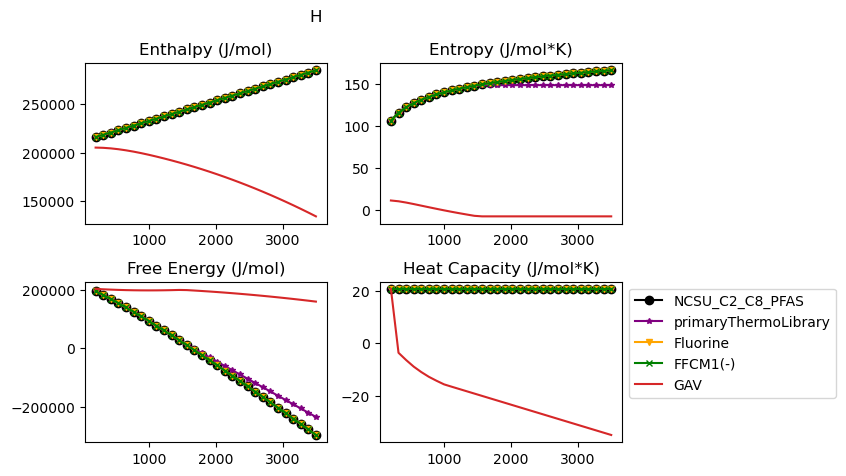

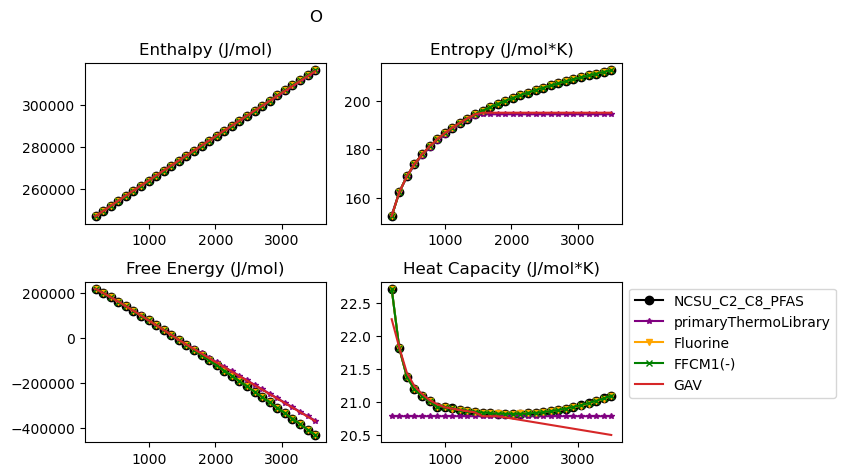

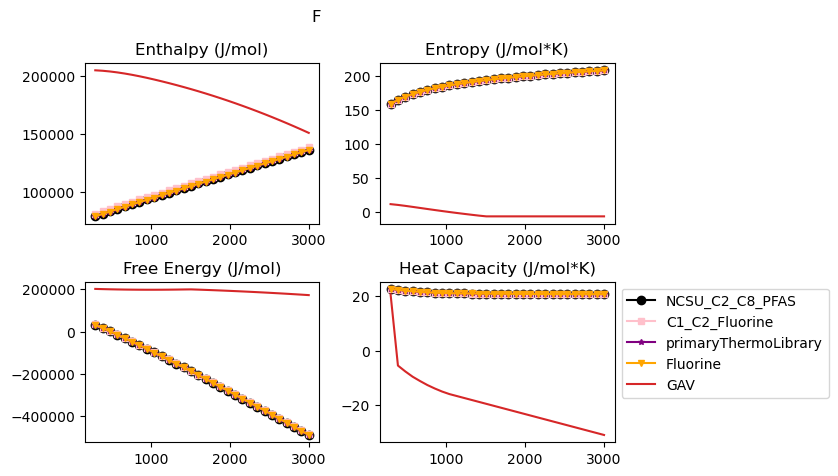

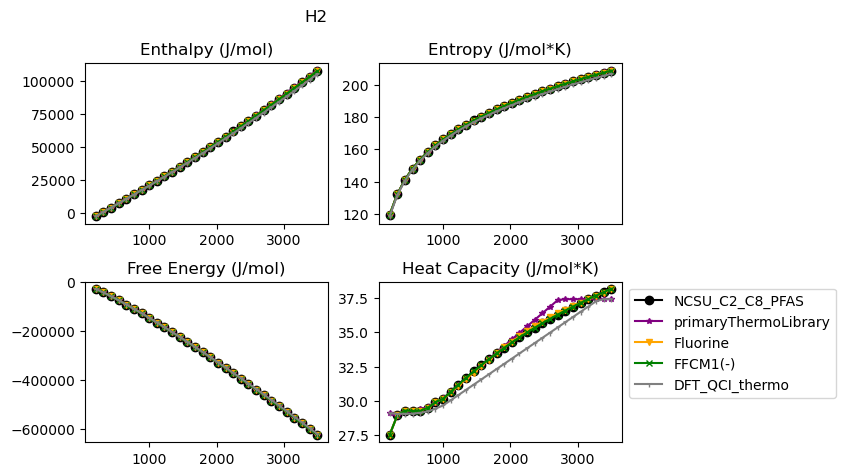

ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([26.945,25.4387,25.9408,28.1165,30.1248,33.0536,37.907],'J/(mol*K)'), H298=(139.972,'kJ/mol'), S298=(219.42,'J/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-OsH) + group(O2s-OsH) + radical(HOOJ) + radical(HOOJ)""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1565.5172413793102 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([26.945,25.4387,25.9408,28.1165,30.1248,33.0536,37.907],'J/(mol*K)'), H298=(139.972,'kJ/mol'), S298=(219.42,'J/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-OsH) + group(O2s-OsH) + radical(HOOJ) + radical(HOOJ)""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1565.5172413793102 K...
ThermoData(Tdata=([300,400,500,600,8

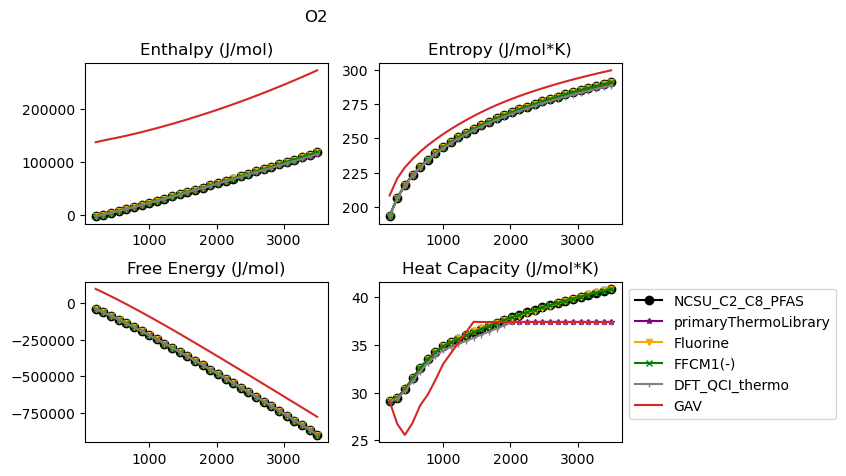

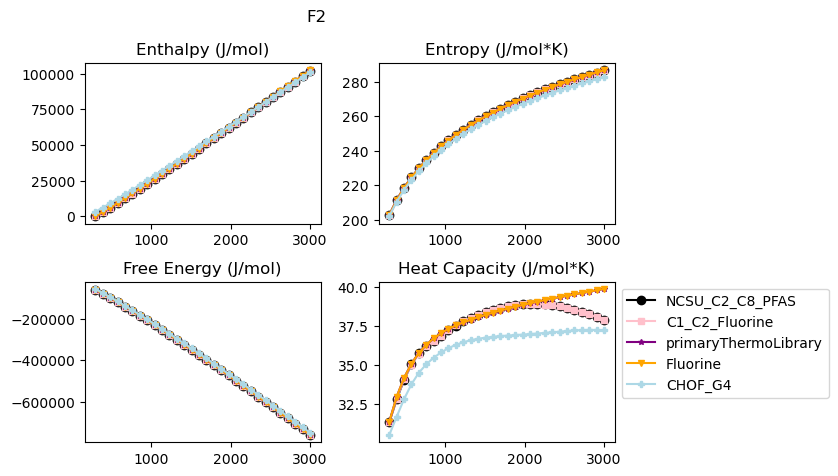

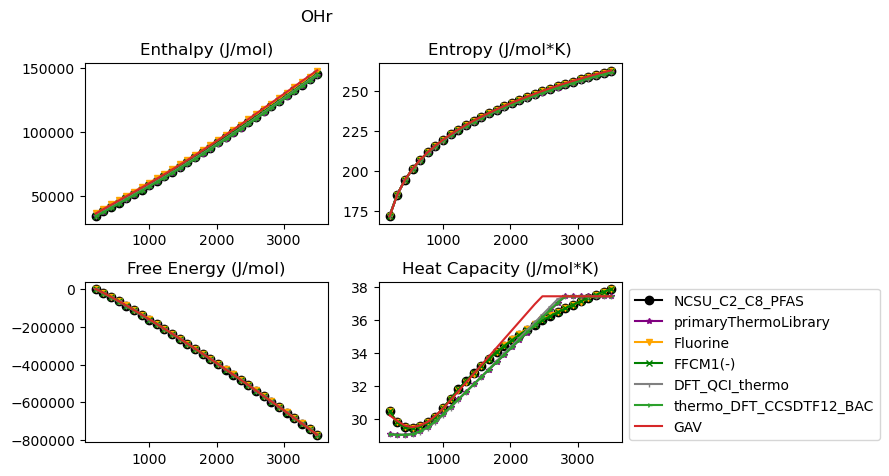

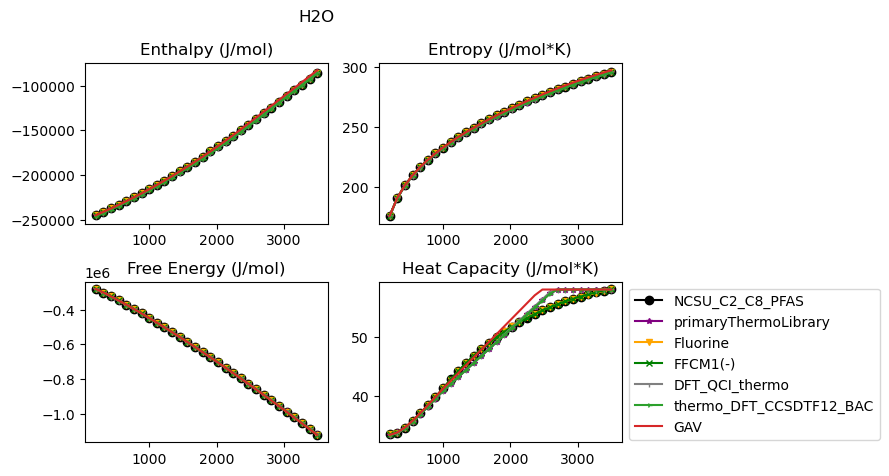

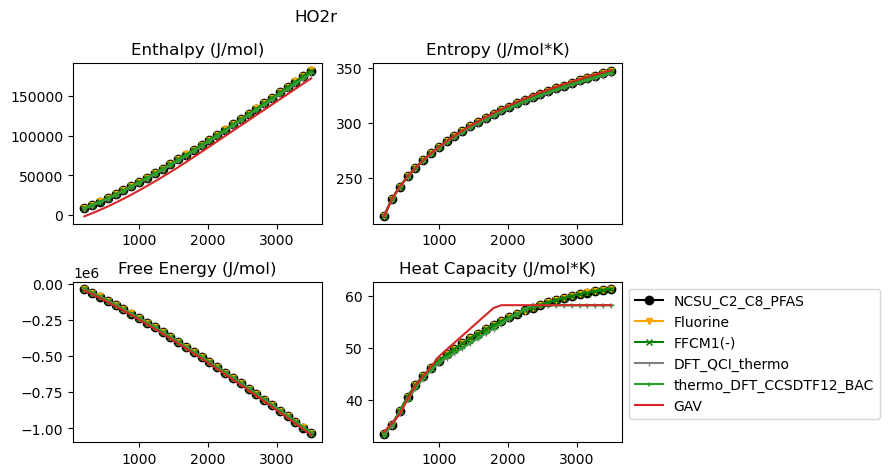

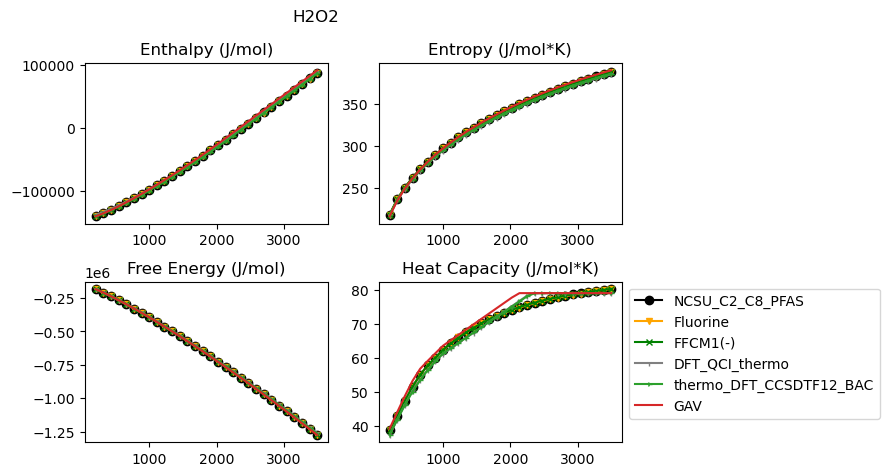

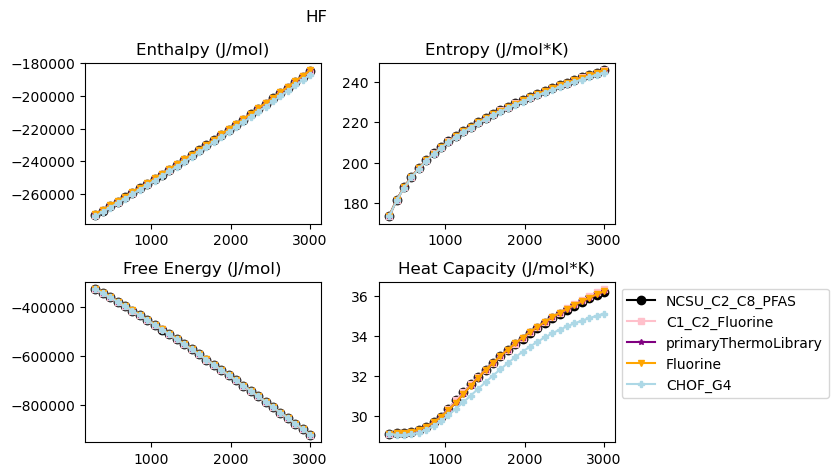

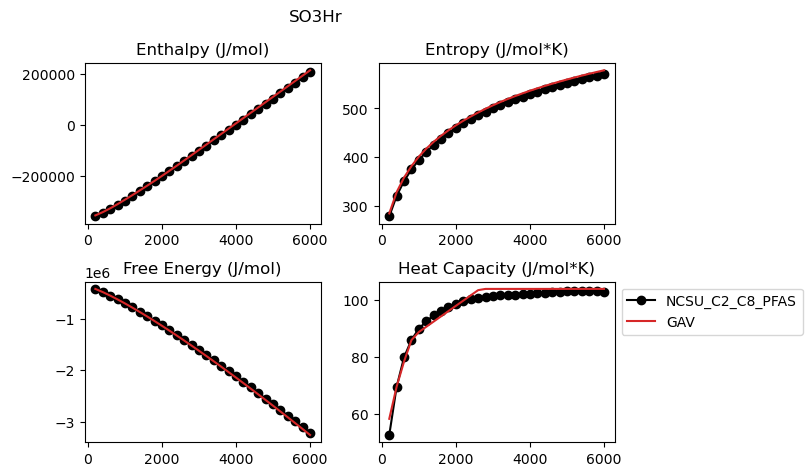

ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([7.22,7.55,7.84,8.08,8.43,8.62,8.95],'cal/(mol*K)'), H298=(23.74,'kcal/mol'), S298=(53.01,'cal/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), label="""SO(S)""", comment="""primaryThermoLibrary""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1595.103448275862 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([7.22,7.55,7.84,8.08,8.43,8.62,8.95],'cal/(mol*K)'), H298=(23.74,'kcal/mol'), S298=(53.01,'cal/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), label="""SO(S)""", comment="""primaryThermoLibrary""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1595.103448275862 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([7.22,7.55,7.84,8.08,8.43,8.62,8.95],'cal/(mol*K)'), H298=(23.74,'kcal/mol'), S298=(53.01,'cal/(mol*K)'), Cp0=(29.1007,'J/(mol

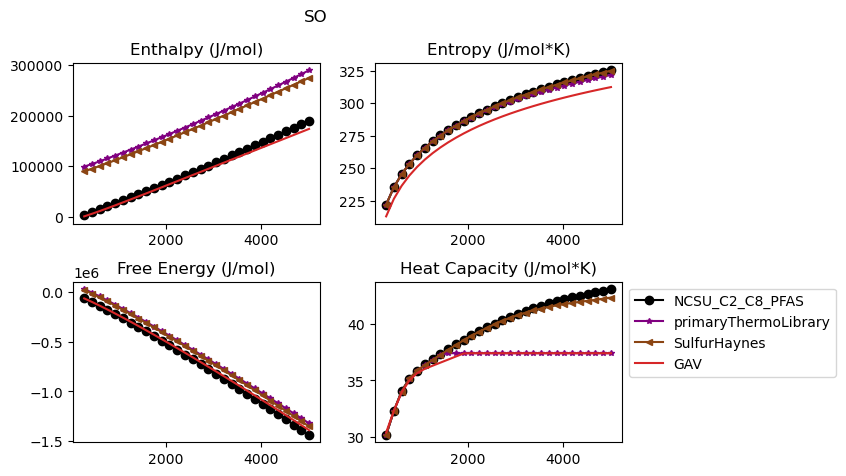

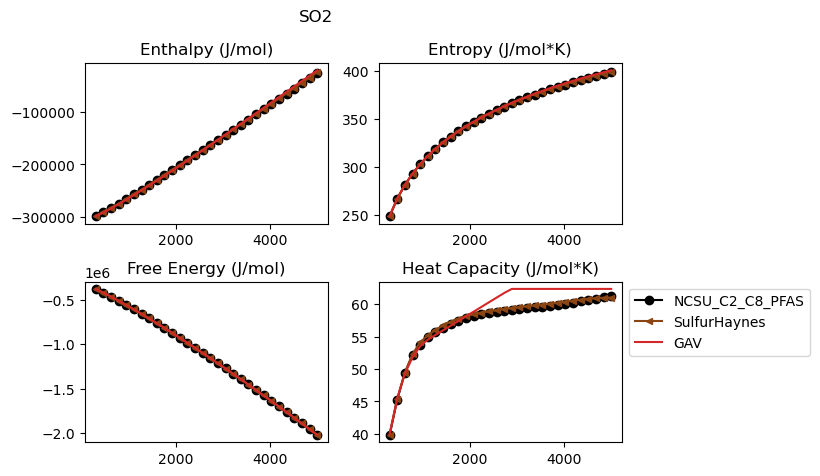

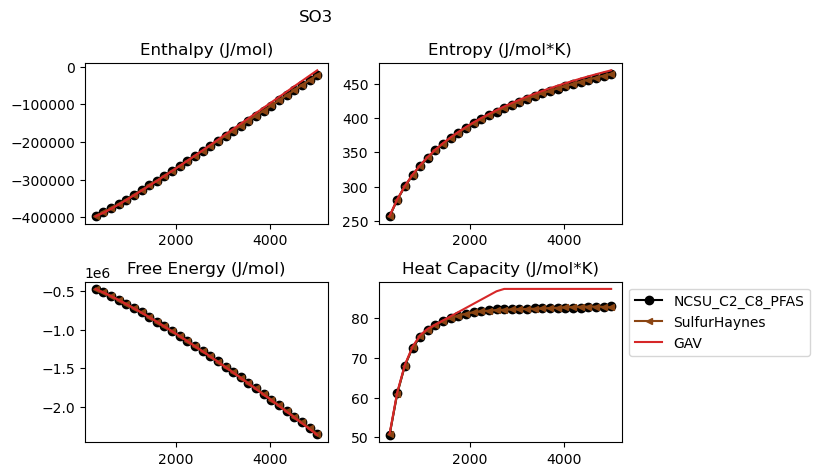

ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([36.6869,38.2195,39.253,40.4473,45.0357,50.6323,54.2027],'J/(mol*K)'), H298=(310.047,'kJ/mol'), S298=(162.808,'J/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-CsCs) + group(CsJ2_singlet-CsH)""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1565.5172413793102 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([36.6869,38.2195,39.253,40.4473,45.0357,50.6323,54.2027],'J/(mol*K)'), H298=(310.047,'kJ/mol'), S298=(162.808,'J/(mol*K)'), Cp0=(29.1007,'J/(mol*K)'), CpInf=(37.4151,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-CsCs) + group(CsJ2_singlet-CsH)""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1565.5172413793102 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([36.6869,38.

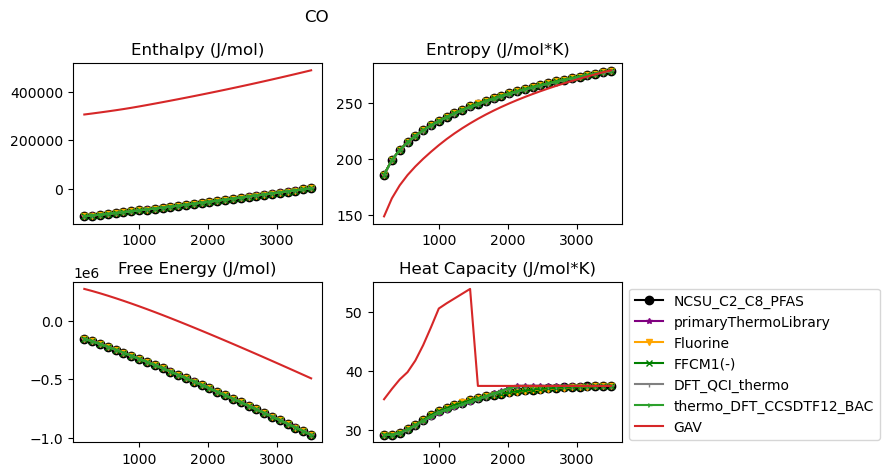

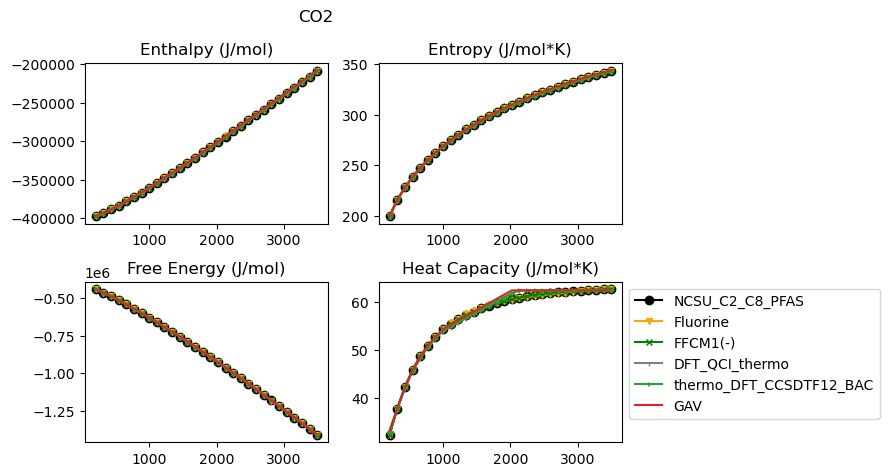

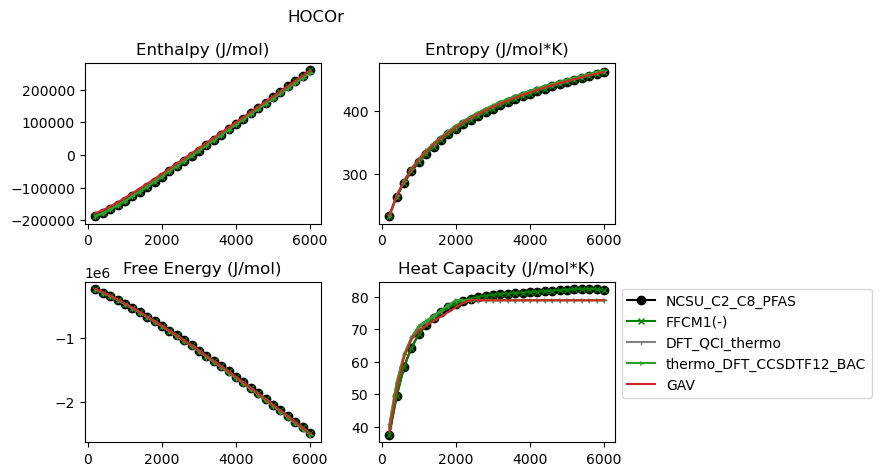

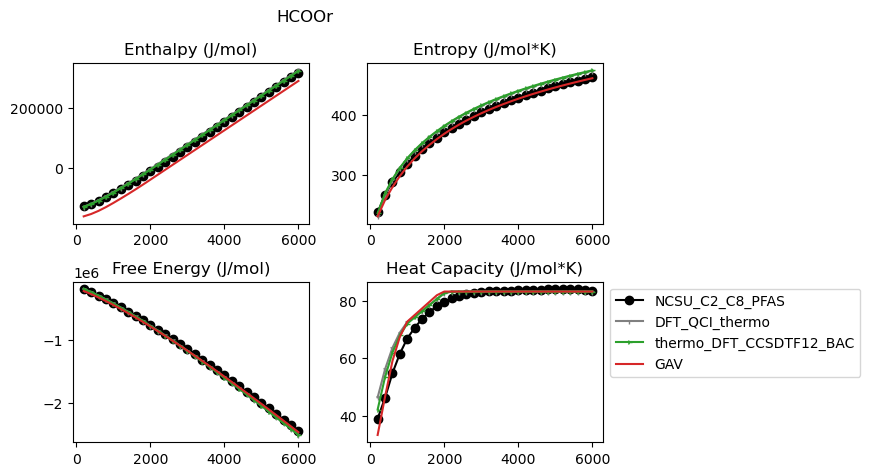

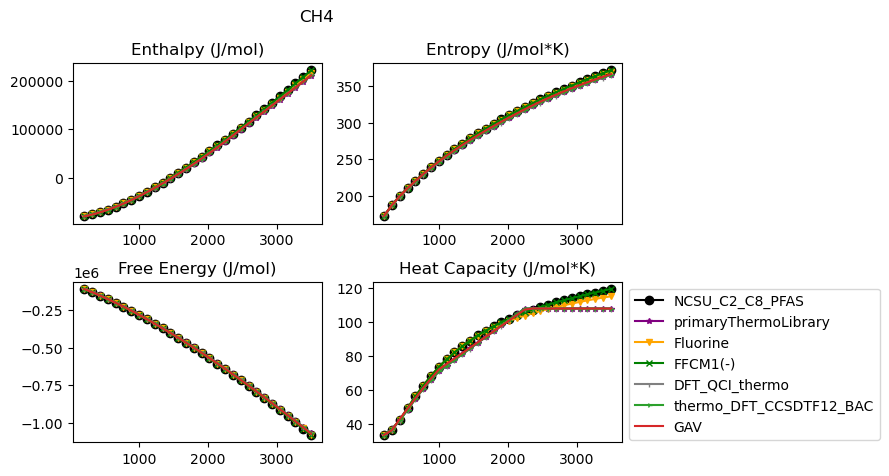

...

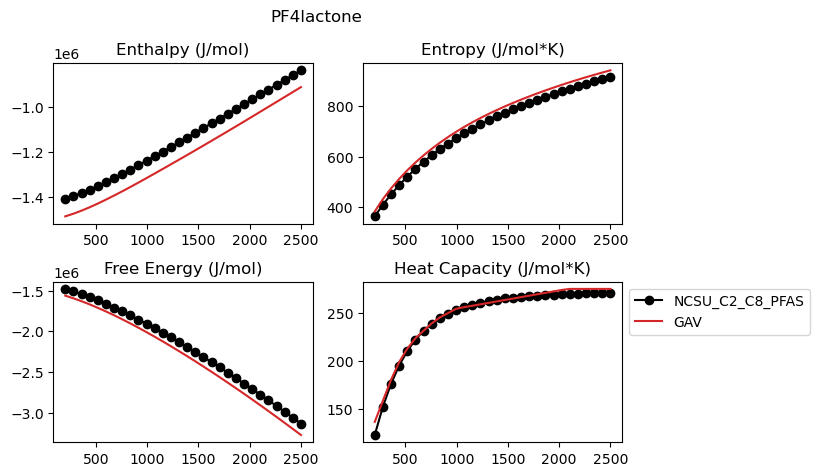

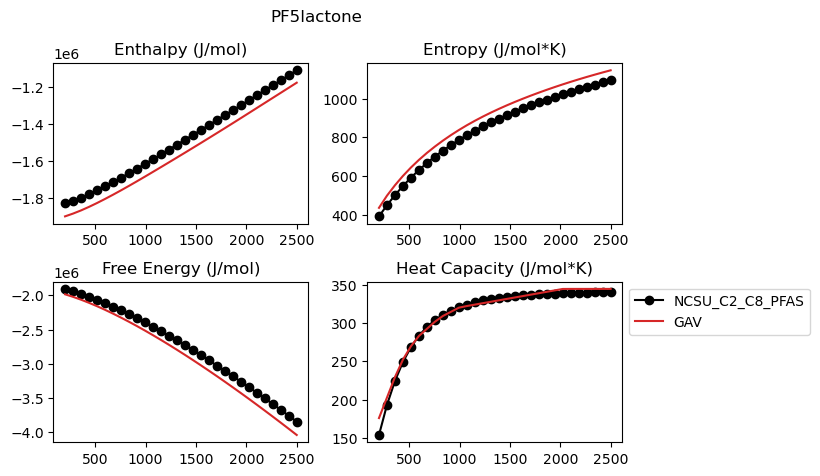

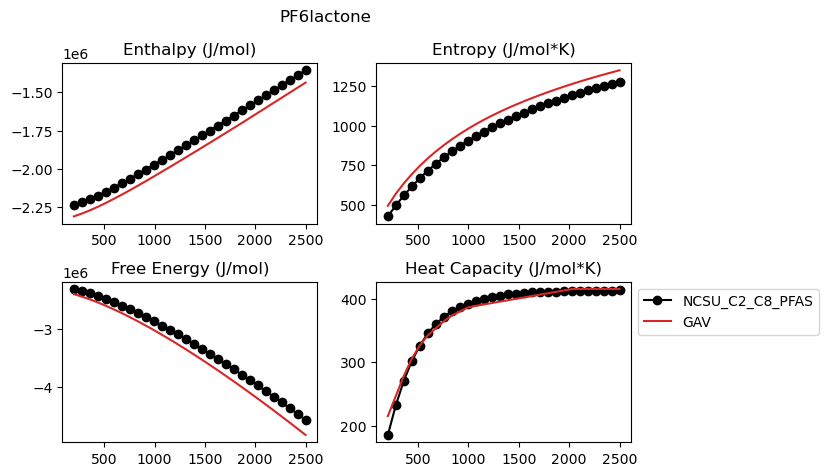

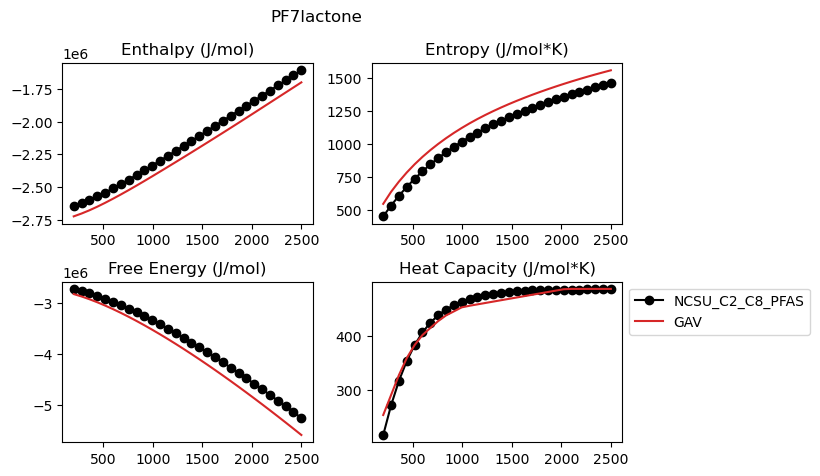

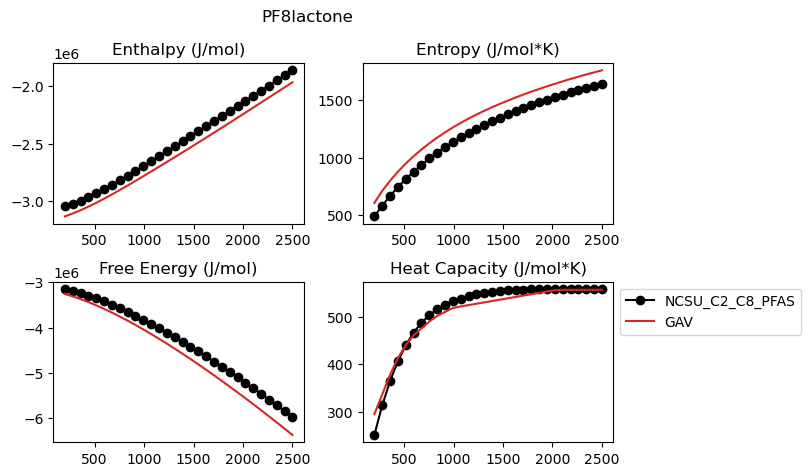

ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([90.3401,104.002,114.961,123.183,134.196,141.537,149.815],'J/(mol*K)'), H298=(-614.801,'kJ/mol'), S298=(333.379,'J/(mol*K)'), Cp0=(33.2579,'J/(mol*K)'), CpInf=(149.66,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-(Cds-O2d)H) + group(CsCFFH) + longDistanceInteraction_noncyclic(Cs(F)2-CO) + group(Cds-OdCsOs) + radical(Csj(CO-O2sO2d)(F1s)(F1s))""").
The thermo for this species is probably wrong! Setting CpInf = Cphigh for Entropy calculationat T = 1548.2758620689656 K...
ThermoData(Tdata=([300,400,500,600,800,1000,1500],'K'), Cpdata=([90.3401,104.002,114.961,123.183,134.196,141.537,149.815],'J/(mol*K)'), H298=(-614.801,'kJ/mol'), S298=(333.379,'J/(mol*K)'), Cp0=(33.2579,'J/(mol*K)'), CpInf=(149.66,'J/(mol*K)'), comment="""Thermo group additivity estimation: group(O2s-(Cds-O2d)H) + group(CsCFFH) + longDistanceInteraction_noncyclic(Cs(F)2-CO) + group(Cds-OdCsOs) + radical(Csj(CO-O2sO2d)(F1s)(F1s))""").


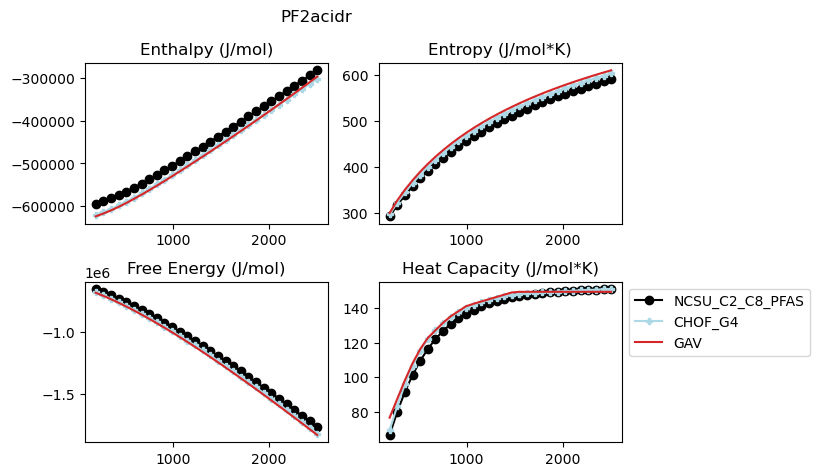

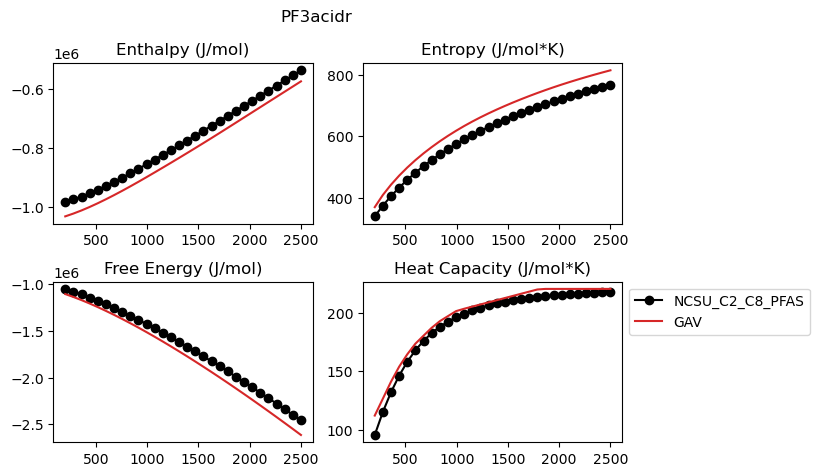

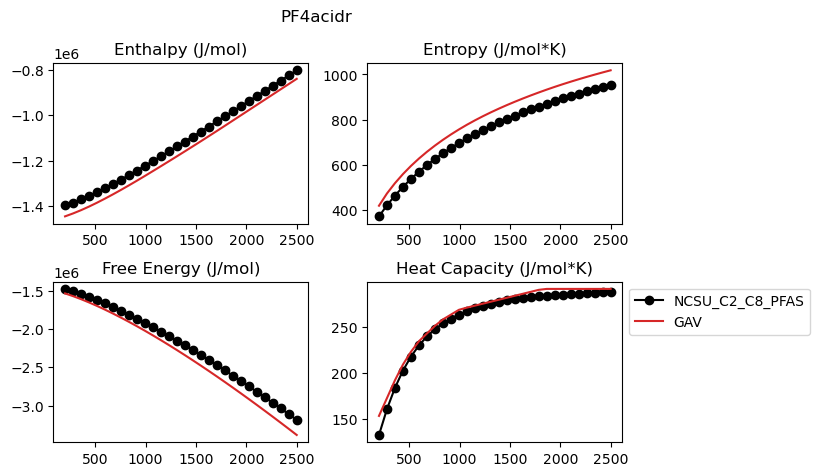

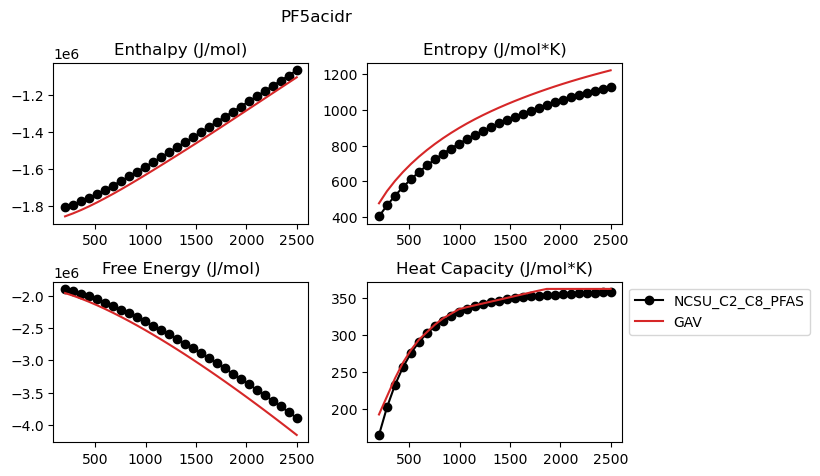

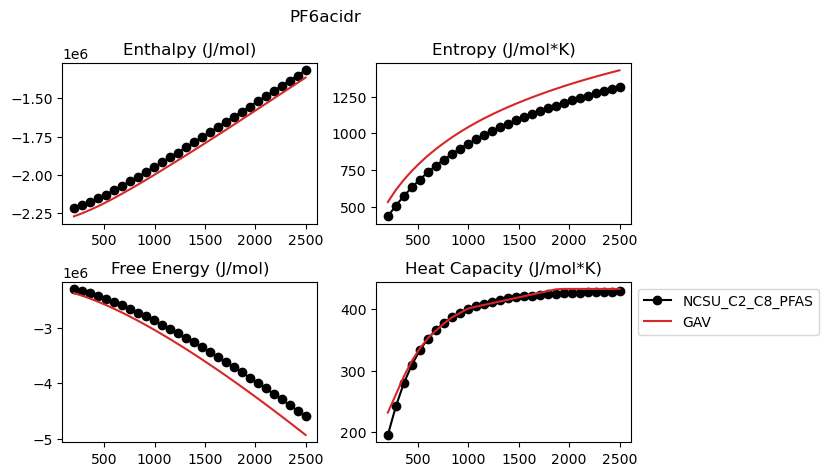

...

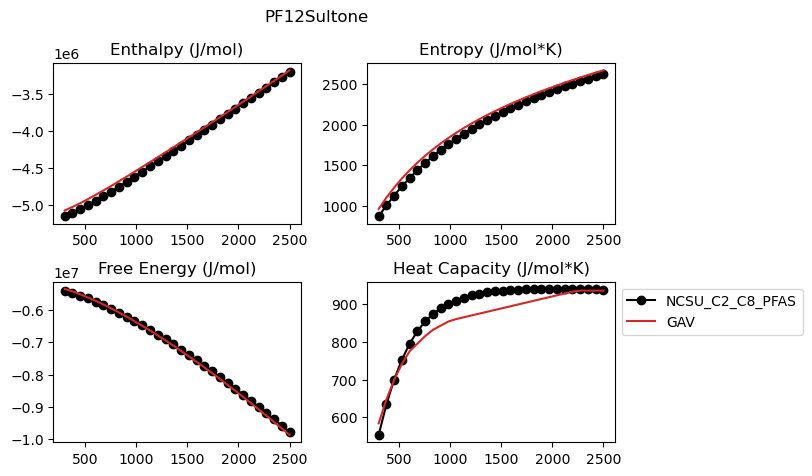

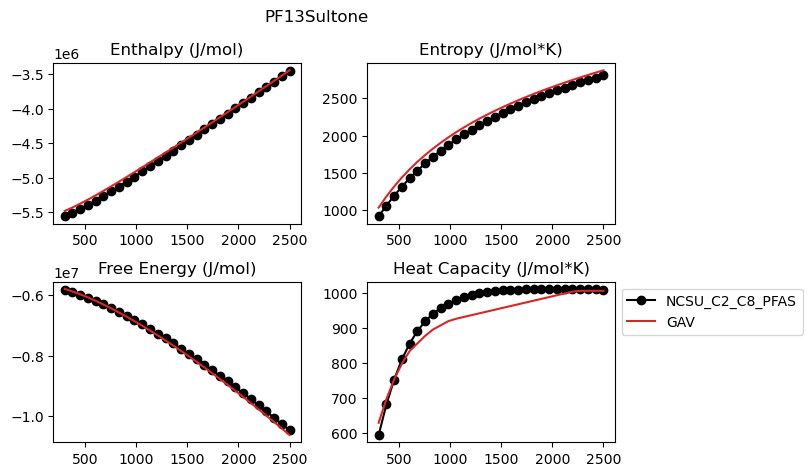

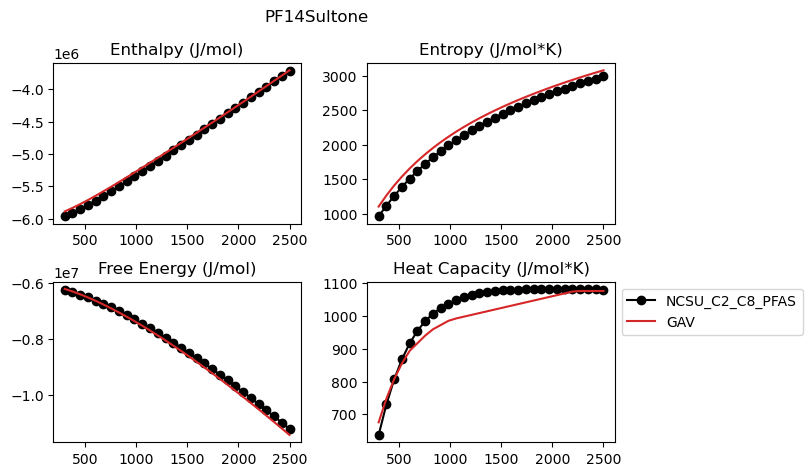

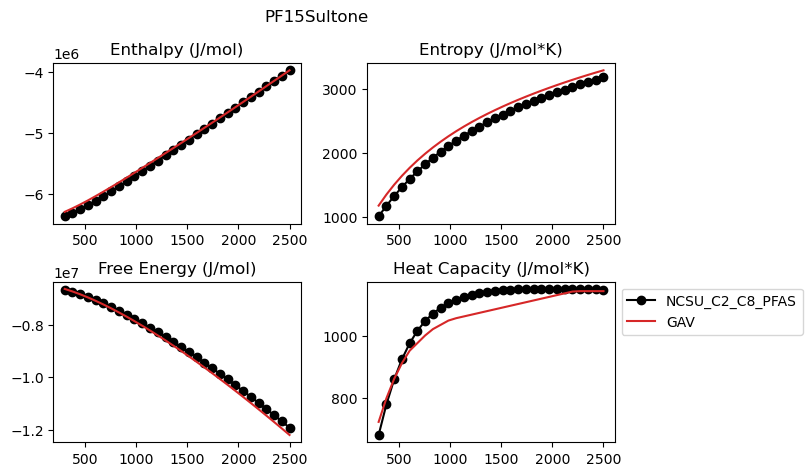

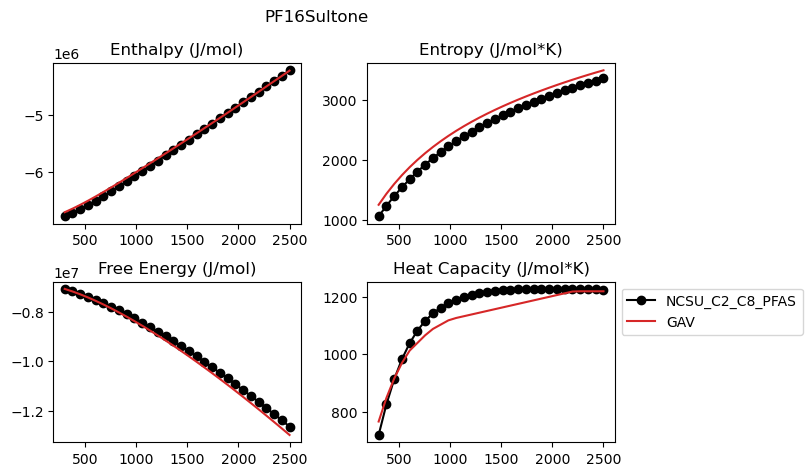

In [8]:
for spc in all_species: 
    
    #to save the data to
    enthalpy = {}
    entropy = {}
    free_energy = {}
    heat_capacity = {}
    
    #T mins and T maxes. Will use to figure out what temp to plot against
    T_mins=[]
    T_maxes=[]
    
    #create species from smiles or adjacency lists 
    value = species_structure_dict[spc.name]
    if type(value)==str:
        SMILES=value
        mole = Molecule(smiles=SMILES)
        adj_list = mole.to_adjacency_list
        spec = Species(molecule=[mole])
    if type(value)==list: 
        SMILES=value[0]
        adj_list = value[1]
        mole = Molecule(smiles=SMILES)
        mole.from_adjacency_list(adj_list)
        spec = Species(molecule=[mole])
        
    #now get the thermo data
    thermo_data = database.thermo.get_all_thermo_data(spec)
    
    #now get all the data for each thermo attribute
    for source in thermo_data:
        thermo_source = source[0]
        
        #append the T maxes and mins
        if thermo_source.Tmax!=None and thermo_source.Tmin!=None:
            T_maxes.append(thermo_source.Tmax.value)
            T_mins.append(thermo_source.Tmin.value)
        
    #now exit loop to get temperature range
    minimum_temp = max(T_mins) #want highest of the minimum
    maximum_temp = min(T_maxes) #want lowest of the maximum 
    temp_range= np.linspace(minimum_temp, maximum_temp, 30)
    
    #now get all the data we need
    for source in thermo_data: 
        thermo_source=source[0]
        if thermo_source.comment=='':
            continue
        
        enth_data=[]
        entr_data=[]
        fe_data=[]
        hc_data=[]
        
        for temp in temp_range: 
            enth_data.append(thermo_source.get_enthalpy(temp)) #J/mol 
            entr_data.append(thermo_source.get_entropy(temp))  #J/mol*K
            fe_data.append(thermo_source.get_free_energy(temp)) # J/mol 
            hc_data.append(thermo_source.get_heat_capacity(temp)) #J/mol*K
        
        if 'Thermo group additivity estimation' in thermo_source.comment: 
            source_name = 'GAV'
        else: 
            source_name = thermo_source.comment
            
        enthalpy[source_name]=enth_data
        entropy[source_name]=entr_data
        free_energy[source_name]=fe_data
        heat_capacity[source_name]=hc_data
        
    
    #let's find the plots where the thermo data doesn't agree
    
    #let's pick out a low, mid, and high temp to compare data at 
    low_T_index, mid_T_index, high_T_index = 1,14,8
    
    #find standard deviation of data
    
    flag_std_devs=False #if flag==False by end of loop, then the variation in thermo data isn't significant
    
    ###### find outliers through std dev
    significant_value = 0.5
    all_std_devs = []
    
    for index in [low_T_index, mid_T_index, high_T_index]: 
        enthalpy_std_dev = get_std_dev(enth_data[index])
        entropy_std_dev = get_std_dev(entr_data[index])
        free_energy_std_dev = get_std_dev(fe_data[index])
        heat_cap_std_dev = get_std_dev(hc_data[index])
        
        all_std_devs.extend([enthalpy_std_dev, entropy_std_dev, free_energy_std_dev, heat_cap_std_dev])
    
    flag_std_devs = all(i > significant_value for i in all_std_devs) #if there's a high std dev, this will change the flag True

    
    ###### if 5 or more data points, let's also use IQR to find outliers
    delta_multiplier = 0.5
    
    if len(enthalpy.keys())>=5: #first see if we have enough thermo data from different sources
        
        flag_IQR = False
        
        for index in [low_T_index, mid_T_index, high_T_index]: 
            
            #get all of the thermo data at that particular temp
            enth_data_from_various_sources = [data[index] for source_name, data in enthalpy.items()]
            entr_data_from_various_sources= [data[index] for source_name, data in entropy.items()]
            fe_data_from_various_sources= [data[index] for source_name, data in free_energy.items()]
            hc_data_from_various_sources= [data[index] for source_name, data in heat_capacity.items()]
            
            
            flag_1 = find_outliers_with_IQR(enth_data_from_various_sources, delta_multiplier)
            flag_2 = find_outliers_with_IQR(entr_data_from_various_sources, delta_multiplier)
            flag_3 = find_outliers_with_IQR(fe_data_from_various_sources, delta_multiplier)
            flag_4 = find_outliers_with_IQR(hc_data_from_various_sources, delta_multiplier)
            
            if True in [flag_1, flag_2, flag_3, flag_4]:
                flag_IQR = True
        
        
   
    ###### plotting
    if flag_std_devs==True or flag_IQR==True:
        

        fig, axs = plt.subplots(2, 2)
        fig.suptitle(spc.name)

        for source_name, thermo_data in enthalpy.items():
            [color, style, ms]=format_plots[source_name]
            axs[0,0].plot(temp_range, thermo_data, style, c=color,  markersize=ms, label=source_name)
            axs[0,0].set_title('Enthalpy (J/mol)') 

        for source_name, thermo_data in entropy.items():
            [color, style, ms]=format_plots[source_name]
            axs[0,1].plot(temp_range, thermo_data, style, c=color,  markersize=ms, label=source_name)
            axs[0,1].set_title('Entropy (J/mol*K)') 

        for source_name, thermo_data in free_energy.items():
            [color, style, ms]=format_plots[source_name]
            axs[1,0].plot(temp_range, thermo_data, style, c=color, markersize=ms,  label=source_name)
            axs[1,0].set_title('Free Energy (J/mol)') 

        for source_name, thermo_data in heat_capacity.items():
            [color, style, ms]=format_plots[source_name]
            axs[1,1].plot(temp_range, thermo_data, style, c=color, markersize=ms, label=source_name)
            axs[1,1].set_title('Heat Capacity (J/mol*K)') 

        fig.tight_layout(pad=1.0)
        plt.legend(bbox_to_anchor=[1,1])
        plt.show()
        print('\n\n\n')

